In [2]:
# 분석 라이브러리
import pandas as pd
import numpy as np

# 시각화 라이브러리
import matplotlib.pyplot as plt
import seaborn as sns

# 한글 깨짐방지
# plt.rcParams['font.family'] = 'Malgun Gothic' # For Windows
plt.rcParams['font.family'] = 'AppleGothic' # For MacOS
%matplotlib inline

# 음수 부호 깨짐 방지
import matplotlib as mpl
mpl.rc('font', family='AppleGothic')

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

def regression_metrics(y_true, y_pred, n_features):
    """

    Parameters:
    - y_true: 실제 값 (array-like)
    - y_pred: 예측 값 (array-like)
    - n_features: 입력 변수(특성) 수 (int)

    Returns:
    - dict: MSE, MAE, RMSE, R2, Adjusted R2
    """
    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    n = len(y_true)
    adj_r2 = 1 - (1 - r2) * (n - 1) / (n - n_features - 1)

    return {
        "MSE": mse,
        "MAE": mae,
        "RMSE": rmse,
        "R2": r2, # 1-어쩌구저쩌구(성능을저하시키는지표) = 전체 성능에서 얼마나 방해가 있었는지 알려주는 지표. 얘가 마이너스면? 모델이 동전던지기보다 못 맞힌다.
        "Adjusted R2": adj_r2
    }

In [4]:
milk = pd.read_csv('../../data/interim/milk.csv', dtype={'개체번호':str})

In [5]:
milk.columns

Index(['농장아이디', '개체번호', '검정일자', '누적착유일(연계)', '유지방율', '유단백', '무지고형분', '체세포수',
       'MUN', '305일유량', '305일유지량', '305일유단백', '305일무지고형분', '성년유량', '성년유지량',
       '성년유단백량', '성년무지고형분량', '전산차비유지속성', '현재산차비유지속성', '비유최고도달일수', '비유후기최고유량',
       '비유초기평균유지율', '비유초기평균단백율', '비유초기평균MUN', '최고유량체세포', '건유전마지막유량',
       '전산차건유전유량', '출생일자', '산차', '농후사료비(연계)', '농후사료급여량(연계)', '공태일수', '유량',
       '질병군', '우유등급', '비유최고도달일수_log', '건유전마지막유량_log', '공태일수_log', '출생년도',
       'PF비'],
      dtype='object')

In [6]:
milk.isna().sum()

농장아이디               0
개체번호                0
검정일자                0
누적착유일(연계)           0
유지방율            16357
유단백             16357
무지고형분           16357
체세포수                0
MUN             16357
305일유량          14763
305일유지량         14763
305일유단백         14763
305일무지고형분       14763
성년유량            14763
성년유지량           14763
성년유단백량          14763
성년무지고형분량        14763
전산차비유지속성            1
현재산차비유지속성           1
비유최고도달일수            1
비유후기최고유량            1
비유초기평균유지율           1
비유초기평균단백율           2
비유초기평균MUN          57
최고유량체세포             0
건유전마지막유량        24717
전산차건유전유량        24717
출생일자                0
산차               3449
농후사료비(연계)           0
농후사료급여량(연계)         0
공태일수                0
유량                  0
질병군                 0
우유등급                0
비유최고도달일수_log        1
건유전마지막유량_log    24717
공태일수_log            0
출생년도                0
PF비             16522
dtype: int64

In [7]:
df = milk.dropna(subset=['305일유량'])

In [8]:
df.isna().sum()

농장아이디               0
개체번호                0
검정일자                0
누적착유일(연계)           0
유지방율            10479
유단백             10479
무지고형분           10479
체세포수                0
MUN             10479
305일유량              0
305일유지량             0
305일유단백             0
305일무지고형분           0
성년유량                0
성년유지량               0
성년유단백량              0
성년무지고형분량            0
전산차비유지속성            0
현재산차비유지속성           0
비유최고도달일수            0
비유후기최고유량            0
비유초기평균유지율           0
비유초기평균단백율           0
비유초기평균MUN          56
최고유량체세포             0
건유전마지막유량        17159
전산차건유전유량        17159
출생일자                0
산차                  0
농후사료비(연계)           0
농후사료급여량(연계)         0
공태일수                0
유량                  0
질병군                 0
우유등급                0
비유최고도달일수_log        0
건유전마지막유량_log    17159
공태일수_log            0
출생년도                0
PF비             10592
dtype: int64

In [9]:
df.columns

Index(['농장아이디', '개체번호', '검정일자', '누적착유일(연계)', '유지방율', '유단백', '무지고형분', '체세포수',
       'MUN', '305일유량', '305일유지량', '305일유단백', '305일무지고형분', '성년유량', '성년유지량',
       '성년유단백량', '성년무지고형분량', '전산차비유지속성', '현재산차비유지속성', '비유최고도달일수', '비유후기최고유량',
       '비유초기평균유지율', '비유초기평균단백율', '비유초기평균MUN', '최고유량체세포', '건유전마지막유량',
       '전산차건유전유량', '출생일자', '산차', '농후사료비(연계)', '농후사료급여량(연계)', '공태일수', '유량',
       '질병군', '우유등급', '비유최고도달일수_log', '건유전마지막유량_log', '공태일수_log', '출생년도',
       'PF비'],
      dtype='object')

In [10]:
cols = ['누적착유일(연계)', '305일유량', '전산차비유지속성',
    '전산차건유전유량', '산차', '농후사료비(연계)', '농후사료급여량(연계)',
    '비유최고도달일수_log', '건유전마지막유량_log', '공태일수_log', '출생년도']

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/utils.py:61: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) AppleGothic.
  fig.canvas.draw()


<Axes: >

/Users/t2023-m0103/Library/Python/3.10/lib/python/site-packages/IPython/core/events.py:82: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) AppleGothic.
  func(*args, **kwargs)
/Users/t2023-m0103/Library/Python/3.10/lib/python/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) AppleGothic.
  fig.canvas.print_figure(bytes_io, **kw)


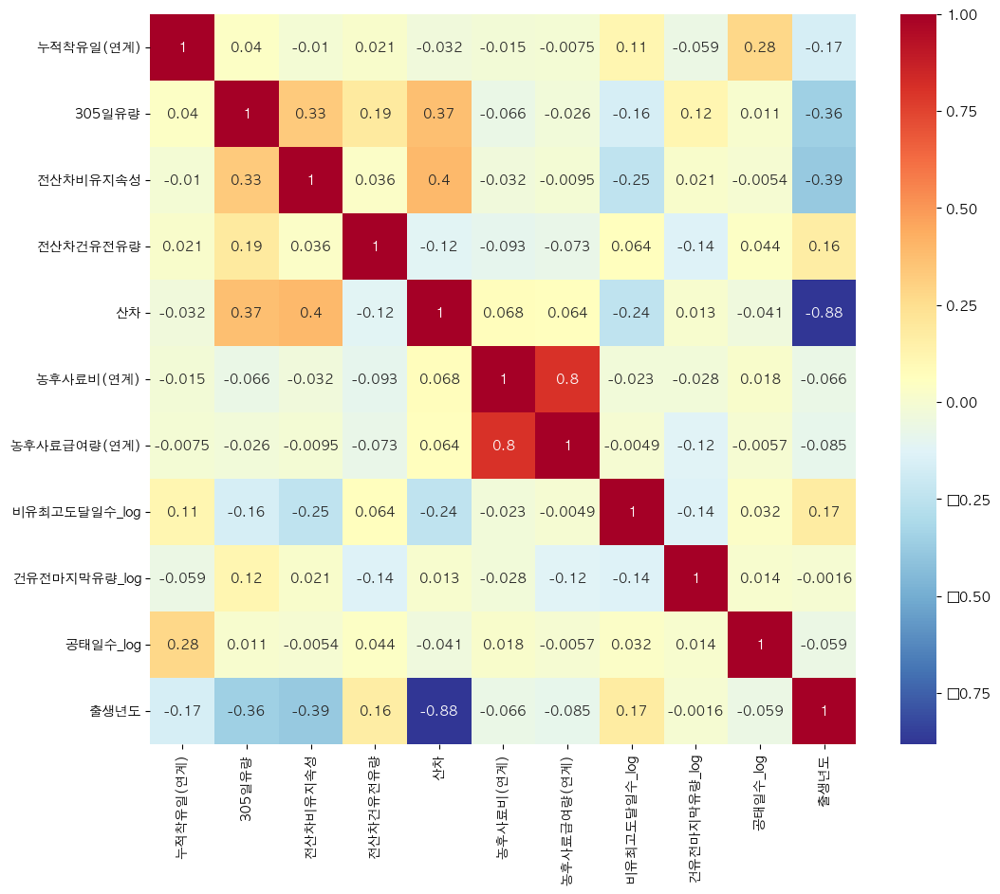

In [11]:
plt.figure(figsize=(12,10))
sns.heatmap(df[cols].corr(), annot=True, cmap='RdYlBu_r')

In [12]:
df_temp = milk.dropna()
cols = ['누적착유일(연계)', '전산차비유지속성',
    '전산차건유전유량', '산차', '농후사료비(연계)', '농후사료급여량(연계)',
    '비유최고도달일수_log', '건유전마지막유량_log', '공태일수_log', '출생년도']

In [13]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df_temp[cols].values, i) for i in range(df_temp[cols].shape[1])]
vif["features"] = df_temp[cols].columns
vif = vif.sort_values("VIF Factor").reset_index(drop=True)
vif

,VIF Factor,features
0,3.135335,전산차비유지속성
1,4.221694,농후사료비(연계)
2,4.432229,공태일수_log
3,4.677385,농후사료급여량(연계)
4,5.909807,누적착유일(연계)
5,6.759005,산차
6,10.980305,전산차건유전유량
7,13.399076,건유전마지막유량_log
8,52.103284,비유최고도달일수_log
9,93.166645,출생년도


In [14]:
final_cols = ['누적착유일(연계)', '전산차비유지속성',
    '전산차건유전유량', '산차', '농후사료비(연계)', '농후사료급여량(연계)',
    '건유전마지막유량_log', '공태일수_log']

vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df_temp[final_cols].values, i) for i in range(df_temp[final_cols].shape[1])]
vif["features"] = df_temp[final_cols].columns
vif = vif.sort_values("VIF Factor").reset_index(drop=True)
vif

,VIF Factor,features
0,2.946166,전산차비유지속성
1,4.218330,농후사료비(연계)
2,4.321864,공태일수_log
3,4.565543,농후사료급여량(연계)
4,5.446623,누적착유일(연계)
5,5.447189,산차
6,7.273157,전산차건유전유량
7,8.151684,건유전마지막유량_log


In [15]:
df['검정일자'] = pd.to_datetime(df['검정일자'])

df_2020 = df[df['검정일자'].dt.year==2020]
df_2021 = df[df['검정일자'].dt.year==2021]

/var/folders/jz/7b91vg4d00z75sw7vt8q3c3h0000gn/T/ipykernel_12632/436753347.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['검정일자'] = pd.to_datetime(df['검정일자'])


In [16]:
target = '305일유량'
final_cols = ['누적착유일(연계)', '전산차비유지속성',
    '전산차건유전유량', '산차', '농후사료비(연계)',
    '건유전마지막유량', '공태일수']

X_train = df_2020[final_cols]
X_test = df_2021[final_cols]

y_train = df_2020[target]
y_test = df_2021[target]

# 모델 돌리기

In [17]:
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV

In [39]:
xgb_model = XGBRegressor(
    objective='reg:squarederror',
    tree_method="hist",
    random_state=42)

param_grid = {
    'n_estimators': [5000, 5500, 6000],
    'max_depth': [2, 3, 4],
    'learning_rate': [0.01, 0.05],
    'reg_alpha': [0, 0.1],
    'reg_lambda': [1, 1.5, 2.0]
    }

In [40]:
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=5,
    scoring='neg_mean_absolute_error',
    verbose=1,
    n_jobs=-1
)

In [41]:
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 108 candidates, totalling 540 fits


,estimator,"XGBRegressor(...ree=None, ...)"
,param_grid,"{'learning_rate': [0.01, 0.05], 'max_depth': [2, 3, ...], 'n_estimators': [5000, 5500, ...], 'reg_alpha': [0, 0.1], ...}"
,scoring,'neg_mean_absolute_error'
,n_jobs,-1
,refit,True
,cv,5
,verbose,1
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,objective,'reg:squarederror'


In [42]:
print("Best Parameters:", grid_search.best_params_)
print("Best Score (Negative MAE):", grid_search.best_score_)

Best Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 5000, 'reg_alpha': 0.1, 'reg_lambda': 2.0}
Best Score (Negative MAE): -1409.1447363242185


In [43]:
y_pred = grid_search.predict(X_test)
regression_metrics(y_test, y_pred, len(final_cols))

{'MSE': 3033022.789876628,
 'MAE': 1345.9587442291856,
 'RMSE': np.float64(1741.5575758144282),
 'R2': 0.2686118382954247,
 'Adjusted R2': 0.2683834935680739}

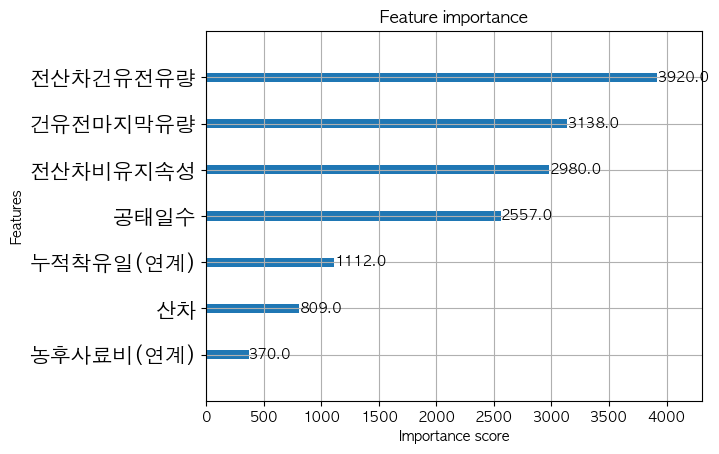

In [44]:
from xgboost import plot_importance
plot_importance(grid_search.best_estimator_)
plt.yticks(fontsize=15)
plt.show()

# 성능 올리기용 세부 조정

In [33]:
from sklearn.model_selection import train_test_split

X_train2, X_valid, y_train2, y_valid = train_test_split(
    X_train, y_train,
    test_size=0.2,
    random_state=42,
)

In [ ]:
xgb_model2 = XGBRegressor(
    objective='reg:squarederror',
    tree_method="exact",
    eval_metric='mae',
    n_estimators=6000,
    learning_rate=0.005, 
    max_depth=5,
    subsample=0.8,
    reg_alpha=0.1,
    reg_lambda=1.2,
    min_child_weight=3,
    gamma=0,
    random_state=42)

xgb_model2.fit(
    X_train2, y_train2,
    eval_set=[(X_valid, y_valid)],
    verbose=False,
)

,objective,'reg:squarederror'
,base_score,None
,booster,None
,callbacks,None
,colsample_bylevel,None
,colsample_bynode,None
,colsample_bytree,None
,device,None
,early_stopping_rounds,None
,enable_categorical,False
,eval_metric,'mae'


In [104]:
y_pred2 = xgb_model2.predict(X_test)
regression_metrics(y_test, y_pred2, len(final_cols))

{'MSE': 2856326.748173867,
 'MAE': 1298.377597040592,
 'RMSE': np.float64(1690.0670839271047),
 'R2': 0.3112206157674575,
 'Adjusted R2': 0.31100557381171834}

In [ ]:
# import joblib

# 저장
# joblib.dump(xgb_model2, '../../models/milk_best_1106_0527.pkl')

# # 불러오기
# loaded_rf = joblib.load('xgb_model2.pkl')
# y_pred_loaded = loaded_rf.predict(X_test)

['../../models/milk_best_1106_0526.pkl']

* 0505 - adjusted r2: 0.297

* 0518 - r2: 0.3058 adjusted r2: 0.3056

* 0523 - r2: 0.3105 adjusted r2: 0.3103

* 0526 - r2: 0.3112 adjusted r2: 0.3110

# 차라리 다중회귀를 해보자

In [18]:
from sklearn.linear_model import ElasticNet, ElasticNetCV
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline

In [111]:
pipeline = Pipeline([
    ('imputer', SimpleImputer(
        strategy='median', # 일단 중앙값
        add_indicator=True
    )),
    ('standard_scaler', StandardScaler()),
    ('elasticnet', ElasticNetCV(
        l1_ratio=[0.05, 0.1, 0.3, 0.5, 0.7, 0.9, 0.95],
        alphas=np.logspace(-3, 1, 50),
        cv=5,
        max_iter=5000,
        tol=1e-3,
        random_state=42
    ))
])

pipeline.fit(X_train, y_train)

,steps,"[('imputer', ...), ('standard_scaler', ...), ...]"
,transform_input,None
,memory,None
,verbose,False
,missing_values,nan
,strategy,'median'
,fill_value,None
,copy,True
,add_indicator,True
,keep_empty_features,False
,copy,True


In [112]:
y_pred = pipeline.predict(X_test)

In [114]:
regression_metrics(y_test, y_pred, len(final_cols))

{'MSE': 3243100.234323704,
 'MAE': 1400.3854295240317,
 'RMSE': np.float64(1800.8609702927386),
 'R2': 0.21795341382773648,
 'Adjusted R2': 0.2177092531701741}

# LightGBM 사용

In [19]:
from lightgbm import LGBMRegressor

In [25]:
lgbm_model = LGBMRegressor(
    random_state=42)

param_grid = {
    'n_estimators': [2000, 3000, 5000],
    'learning_rate': [0.05, 0.1],
    'max_depth': [2, 3, 5],
    'num_leaves': [15, 31]
}

grid_search3 = GridSearchCV(
    estimator=lgbm_model,
    param_grid=param_grid,
    scoring='neg_mean_absolute_error',
    cv=3,
    n_jobs=-1
)

grid_search3.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000912 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1093
[LightGBM] [Info] Number of data points in the train set: 14132, number of used features: 7
[LightGBM] [Info] Start training from score 10233.571115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000544 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1164
[LightGBM] [Info] Number of data points in the train set: 14133, number of used features: 7
[Li

,estimator,LGBMRegressor(random_state=42)
,param_grid,"{'learning_rate': [0.05, 0.1], 'max_depth': [2, 3, ...], 'n_estimators': [2000, 3000, ...], 'num_leaves': [15, 31]}"
,scoring,'neg_mean_absolute_error'
,n_jobs,-1
,refit,True
,cv,3
,verbose,0
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,boosting_type,'gbdt'


In [26]:
print("Best Parameters:", grid_search3.best_params_)
print("Best Score (Negative MAE):", grid_search3.best_score_)

Best Parameters: {'learning_rate': 0.05, 'max_depth': 2, 'n_estimators': 2000, 'num_leaves': 15}
Best Score (Negative MAE): -1483.8970757048676


In [27]:
y_pred3 = grid_search3.predict(X_test)

In [28]:
regression_metrics(y_test, y_pred3, len(final_cols))

{'MSE': 3014727.815940031,
 'MAE': 1345.3672934721046,
 'RMSE': np.float64(1736.2971565777648),
 'R2': 0.2730235187485297,
 'Adjusted R2': 0.27279655138004655}

In [36]:
len(final_cols)

7

# 모델 세부 조정

In [119]:
lgb_params = {
    'metric': 'mae',
    'learning_rate': 0.1,
    'max_depth': 3,
    'num_leaves': 14,
    'n_estimators': 900,
    'min_child_samples': 7,
    'min_child_weight': 1e-3, 
    'subsample': 0.8,
    'subsample_freq': 1,
    'colsample_bytree': 0.8,
    'reg_alpha': 0.0,
    'reg_lambda': 2.0,
    'bagging_seed': 42,
    'feature_fraction_seed': 42,
    'random_state': 42}

lgbm_model = LGBMRegressor(**lgb_params)

lgbm_model.fit(
    X_train2, y_train2,
    eval_set=[(X_valid, y_valid)],
    eval_metric='mae',
)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1180
[LightGBM] [Info] Number of data points in the train set: 16959, number of used features: 7
[LightGBM] [Info] Start training from score 10736.900289
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

,boosting_type,'gbdt'
,num_leaves,14
,max_depth,3
,learning_rate,0.1
,n_estimators,900
,subsample_for_bin,200000
,objective,None
,class_weight,None
,min_split_gain,0.0
,min_child_weight,0.001
,min_child_samples,7


In [120]:
y_pred4 = lgbm_model.predict(X_test)

In [121]:
regression_metrics(y_test, y_pred4, len(final_cols))

{'MSE': 2941955.8237368744,
 'MAE': 1323.135004843803,
 'RMSE': np.float64(1715.213054910927),
 'R2': 0.29057187802189066,
 'Adjusted R2': 0.29035038937937485}